In [ ]:
import numpy as np
from tqdm import tqdm
import cv2
import os
import shutil
import itertools
import imutils
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix

import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
from plotly import tools

from keras.preprocessing.image import ImageDataGenerator
from keras.applications.vgg16 import VGG16, preprocess_input
from keras import layers
from keras.models import Model, Sequential
from keras.optimizers import Adam, RMSprop
from keras.callbacks import EarlyStopping

init_notebook_mode(connected=True)
RANDOM_SEED = 123

In [ ]:
IMG_PATH = '/content/drive/MyDrive/brain_tumor_data/brain_tumor_dataset/'

# Create destination directories
os.makedirs('TEST', exist_ok=True)
os.makedirs('TRAIN', exist_ok=True)
os.makedirs('VAL', exist_ok=True)

# Split the data by train/val/test
for CLASS in os.listdir(IMG_PATH):
    if not CLASS.startswith('.'):
        class_path = os.path.join(IMG_PATH, CLASS)
        IMG_NUM = len(os.listdir(class_path))

        # Create subdirectories for each class in TEST, TRAIN, and VAL
        os.makedirs(os.path.join('TEST', CLASS.upper()), exist_ok=True)
        os.makedirs(os.path.join('TRAIN', CLASS.upper()), exist_ok=True)
        os.makedirs(os.path.join('VAL', CLASS.upper()), exist_ok=True)

        for (n, FILE_NAME) in enumerate(os.listdir(class_path)):
            img = os.path.join(class_path, FILE_NAME)

            if n < 5:
                shutil.copy(img, os.path.join('TEST', CLASS.upper(), FILE_NAME))
            elif n < int(0.8 * IMG_NUM):
                shutil.copy(img, os.path.join('TRAIN', CLASS.upper(), FILE_NAME))
            else:
                shutil.copy(img, os.path.join('VAL', CLASS.upper(), FILE_NAME))

In [ ]:
def load_data(dir_path, img_size=(100,100)):
    """
    Load resized images as np.arrays to workspace
    """
    X = []
    y = []
    i = 0
    labels = dict()
    for path in tqdm(sorted(os.listdir(dir_path))):
        if not path.startswith('.'):
            labels[i] = path
            for file in os.listdir(dir_path + path):
                if not file.startswith('.'):
                    img = cv2.imread(dir_path + path + '/' + file)
                    X.append(img)
                    y.append(i)
            i += 1
    X = np.array(X)
    y = np.array(y)
    print(f'{len(X)} images loaded from {dir_path} directory.')
    return X, y, labels



def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    plt.figure(figsize = (6,6))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=90)
    plt.yticks(tick_marks, classes)
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 2.
    cm = np.round(cm,2)
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, cm[i, j],
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.show()

In [ ]:
TRAIN_DIR = 'TRAIN/'
TEST_DIR = 'TEST/'
VAL_DIR = 'VAL/'
IMG_SIZE = (224,224)

# use predefined function to load the image data into workspace
X_train, y_train, labels = load_data(TRAIN_DIR, IMG_SIZE)
X_test, y_test, _ = load_data(TEST_DIR, IMG_SIZE)
X_val, y_val, _ = load_data(VAL_DIR, IMG_SIZE)

100%|██████████| 2/2 [00:00<00:00,  5.63it/s]
<ipython-input-44-59831cb31691>:18: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



192 images loaded from TRAIN/ directory.


100%|██████████| 2/2 [00:00<00:00, 132.22it/s]


10 images loaded from TEST/ directory.


100%|██████████| 2/2 [00:00<00:00, 20.68it/s]

51 images loaded from VAL/ directory.


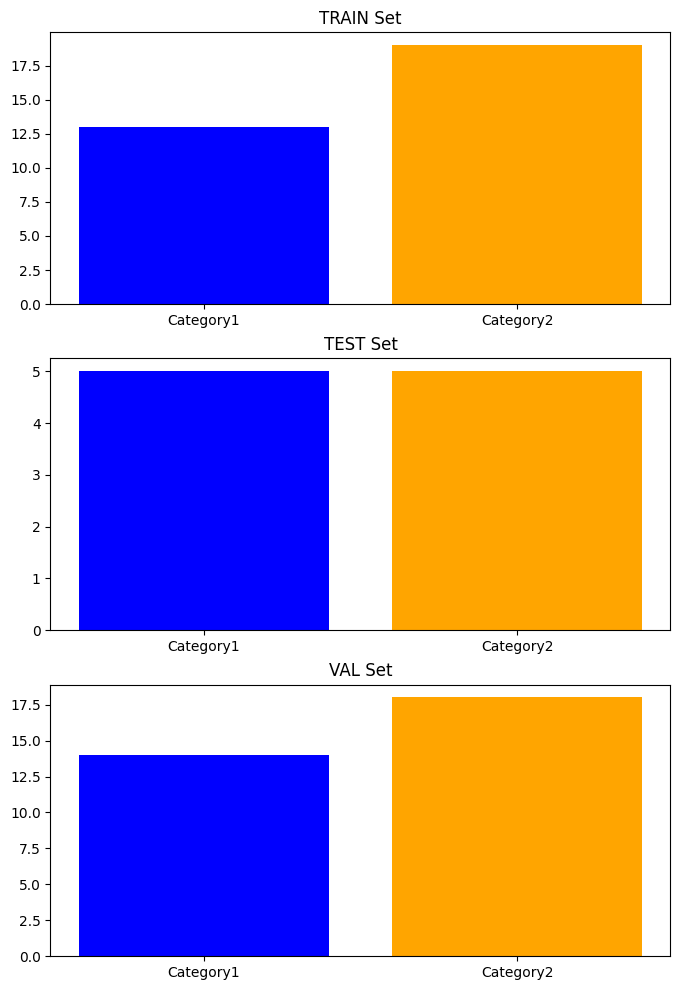

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Sample data (replace with your actual data)
train_categories = ['Category1', 'Category2']
test_categories = ['Category1', 'Category2']
val_categories = ['Category1', 'Category2']

# Count occurrences of each category in the training set
train_counts = [np.sum(y_train[:, i]) for i in range(len(train_categories))]

# Count occurrences of each category in the test set
test_counts = [np.sum(y_test[:, i]) for i in range(len(test_categories))]

# Count occurrences of each category in the validation set
val_counts = [np.sum(y_val[:, i]) for i in range(len(val_categories))]

# Plotting
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Bar chart for TRAIN set
axs[0].bar(train_categories, train_counts, color=['blue', 'orange'])
axs[0].set_title('TRAIN Set')

# Bar chart for TEST set
axs[1].bar(test_categories, test_counts, color=['blue', 'orange'])
axs[1].set_title('TEST Set')

# Bar chart for VAL set
axs[2].bar(val_categories, val_counts, color=['blue', 'orange'])
axs[2].set_title('VAL Set')

plt.show()


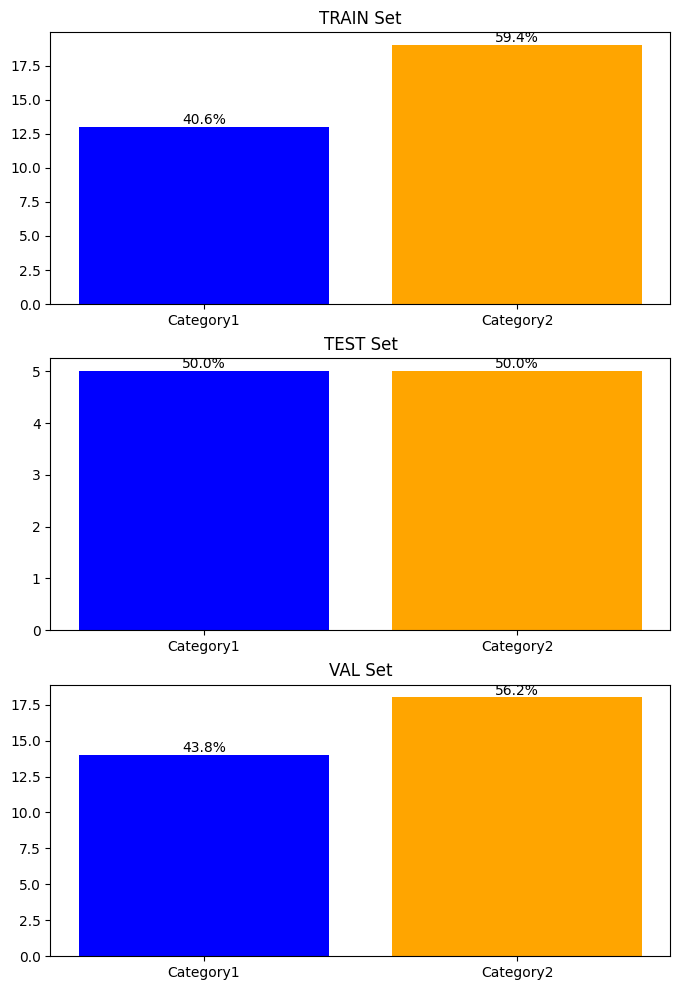

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Sample data (replace with your actual data)
train_categories = ['Category1', 'Category2']
test_categories = ['Category1', 'Category2']
val_categories = ['Category1', 'Category2']

# Count occurrences of each category in the training set
train_counts = [np.sum(y_train[:, i]) for i in range(len(train_categories))]
train_total = np.sum(train_counts)

# Count occurrences of each category in the test set
test_counts = [np.sum(y_test[:, i]) for i in range(len(test_categories))]
test_total = np.sum(test_counts)

# Count occurrences of each category in the validation set
val_counts = [np.sum(y_val[:, i]) for i in range(len(val_categories))]
val_total = np.sum(val_counts)

# Plotting
fig, axs = plt.subplots(3, 1, figsize=(8, 12))

# Bar chart for TRAIN set
bars_train = axs[0].bar(train_categories, train_counts, color=['blue', 'orange'])
axs[0].set_title('TRAIN Set')

# Display percentage values inside the bars for TRAIN set
for bar in bars_train:
    yval = bar.get_height()
    axs[0].text(bar.get_x() + bar.get_width()/2, yval, f'{(yval/train_total)*100:.1f}%', ha='center', va='bottom')

# Bar chart for TEST set
bars_test = axs[1].bar(test_categories, test_counts, color=['blue', 'orange'])
axs[1].set_title('TEST Set')

# Display percentage values inside the bars for TEST set
for bar in bars_test:
    yval = bar.get_height()
    axs[1].text(bar.get_x() + bar.get_width()/2, yval, f'{(yval/test_total)*100:.1f}%', ha='center', va='bottom')

# Bar chart for VAL set
bars_val = axs[2].bar(val_categories, val_counts, color=['blue', 'orange'])
axs[2].set_title('VAL Set')

# Display percentage values inside the bars for VAL set
for bar in bars_val:
    yval = bar.get_height()
    axs[2].text(bar.get_x() + bar.get_width()/2, yval, f'{(yval/val_total)*100:.1f}%', ha='center', va='bottom')

plt.show()


In [ ]:
def plot_samples(X, y, labels_dict, n=50):
    """
    Creates a gridplot for desired number of images (n) from the specified set
    """
    for index in range(len(labels_dict)):
        imgs = X[np.argwhere(y == index)][:n]
        j = 10
        i = int(n/j)

        plt.figure(figsize=(15,6))
        c = 1
        for img in imgs:
            plt.subplot(i,j,c)
            plt.imshow(img[0])

            plt.xticks([])
            plt.yticks([])
            c += 1
        plt.suptitle('Tumor: {}'.format(labels_dict[index]))
        plt.show()

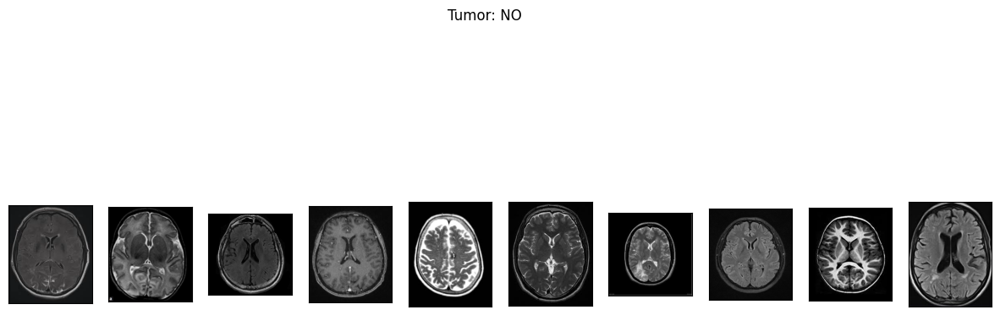

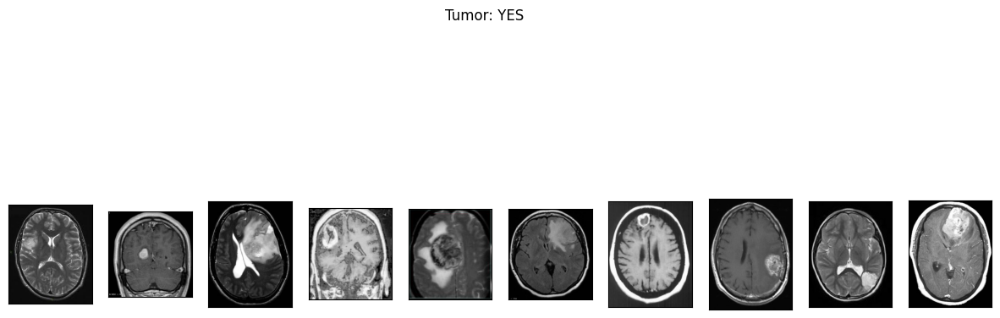

In [ ]:
plot_samples(X_train, y_train, labels, 10)

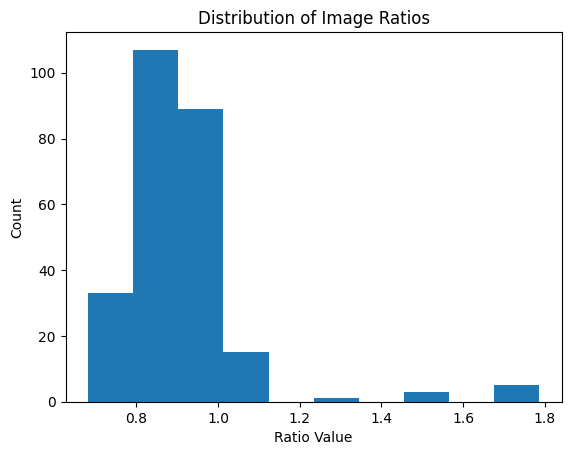

In [ ]:
RATIO_LIST = []
for set in (X_train, X_test, X_val):
    for img in set:
        RATIO_LIST.append(img.shape[1]/img.shape[0])

plt.hist(RATIO_LIST)
plt.title('Distribution of Image Ratios')
plt.xlabel('Ratio Value')
plt.ylabel('Count')
plt.show()

In [ ]:
def crop_imgs(set_name, add_pixels_value=0):
    """
    Finds the extreme points on the image and crops the rectangular out of them
    """
    set_new = []
    for img in set_name:
        gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
        gray = cv2.GaussianBlur(gray, (5, 5), 0)

        # threshold the image, then perform a series of erosions +
        # dilations to remove any small regions of noise
        thresh = cv2.threshold(gray, 45, 255, cv2.THRESH_BINARY)[1]
        thresh = cv2.erode(thresh, None, iterations=2)
        thresh = cv2.dilate(thresh, None, iterations=2)

        # find contours in thresholded image, then grab the largest one
        cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        cnts = imutils.grab_contours(cnts)
        c = max(cnts, key=cv2.contourArea)

        # find the extreme points
        extLeft = tuple(c[c[:, :, 0].argmin()][0])
        extRight = tuple(c[c[:, :, 0].argmax()][0])
        extTop = tuple(c[c[:, :, 1].argmin()][0])
        extBot = tuple(c[c[:, :, 1].argmax()][0])

        ADD_PIXELS = add_pixels_value
        new_img = img[extTop[1]-ADD_PIXELS:extBot[1]+ADD_PIXELS, extLeft[0]-ADD_PIXELS:extRight[0]+ADD_PIXELS].copy()
        set_new.append(new_img)

    return np.array(set_new)

In [ ]:
img = cv2.imread('/content/drive/MyDrive/brain_tumor_data/brain_tumor_dataset/yes/Y108.jpg')
img = cv2.resize(
            img,
            dsize=IMG_SIZE,
            interpolation=cv2.INTER_CUBIC
        )
gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
gray = cv2.GaussianBlur(gray, (5, 5), 0)

# threshold the image, then perform a series of erosions +
# dilations to remove any small regions of noise
thresh = cv2.threshold(gray, 45, 255, cv2.THRESH_BINARY)[1]
thresh = cv2.erode(thresh, None, iterations=2)
thresh = cv2.dilate(thresh, None, iterations=2)

# find contours in thresholded image, then grab the largest one
cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)
c = max(cnts, key=cv2.contourArea)

# find the extreme points
extLeft = tuple(c[c[:, :, 0].argmin()][0])
extRight = tuple(c[c[:, :, 0].argmax()][0])
extTop = tuple(c[c[:, :, 1].argmin()][0])
extBot = tuple(c[c[:, :, 1].argmax()][0])

# add contour on the image
img_cnt = cv2.drawContours(img.copy(), [c], -1, (0, 255, 255), 4)

# add extreme points
img_pnt = cv2.circle(img_cnt.copy(), extLeft, 8, (0, 0, 255), -1)
img_pnt = cv2.circle(img_pnt, extRight, 8, (0, 255, 0), -1)
img_pnt = cv2.circle(img_pnt, extTop, 8, (255, 0, 0), -1)
img_pnt = cv2.circle(img_pnt, extBot, 8, (255, 255, 0), -1)

# crop
ADD_PIXELS = 0
new_img = img[extTop[1]-ADD_PIXELS:extBot[1]+ADD_PIXELS, extLeft[0]-ADD_PIXELS:extRight[0]+ADD_PIXELS].copy()

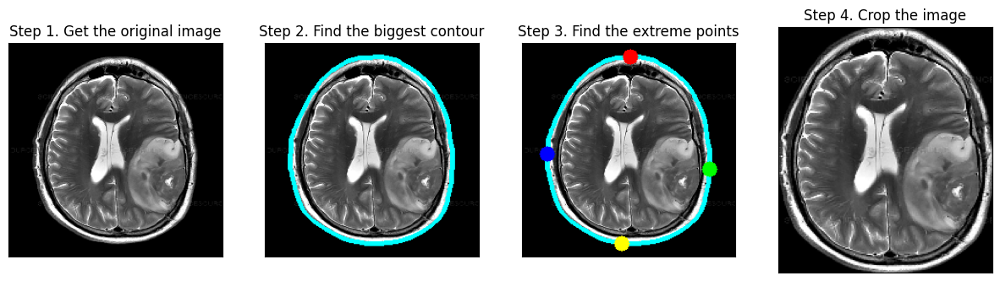

In [ ]:
plt.figure(figsize=(15,6))
plt.subplot(141)
plt.imshow(img)
plt.xticks([])
plt.yticks([])
plt.title('Step 1. Get the original image')
plt.subplot(142)
plt.imshow(img_cnt)
plt.xticks([])
plt.yticks([])
plt.title('Step 2. Find the biggest contour')
plt.subplot(143)
plt.imshow(img_pnt)
plt.xticks([])
plt.yticks([])
plt.title('Step 3. Find the extreme points')
plt.subplot(144)
plt.imshow(new_img)
plt.xticks([])
plt.yticks([])
plt.title('Step 4. Crop the image')
plt.show()

In [ ]:
# apply this for each set
X_train_crop = crop_imgs(set_name=X_train)
X_val_crop = crop_imgs(set_name=X_val)
X_test_crop = crop_imgs(set_name=X_test)

<ipython-input-51-65876982ba26>:31: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.



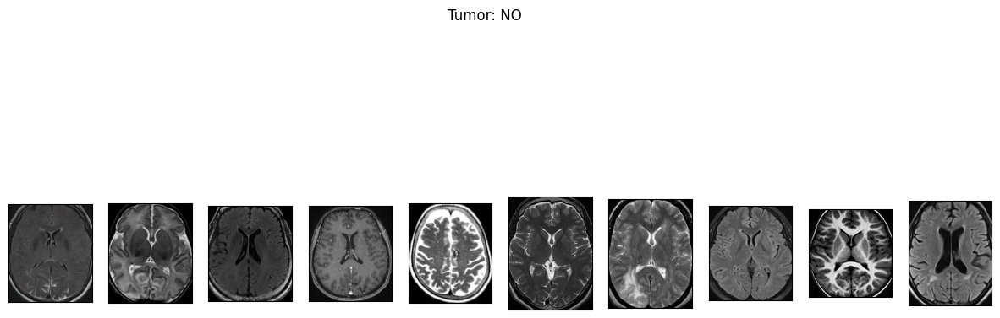

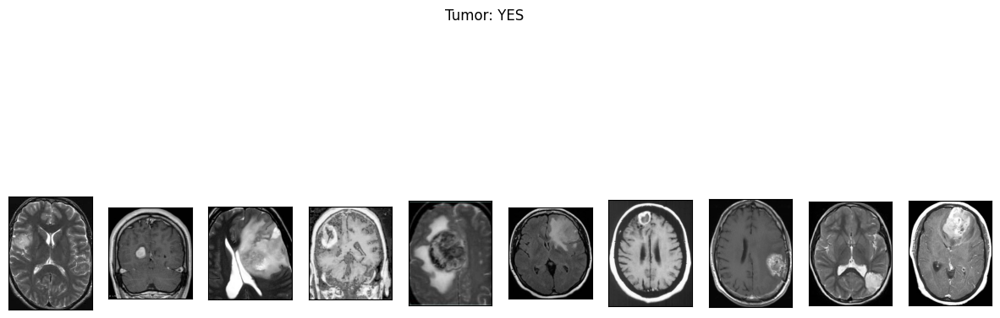

In [ ]:
plot_samples(X_train_crop, y_train, labels, 10)

In [ ]:
def save_new_images(x_set, y_set, folder_name):
    i = 0
    for (img, imclass) in zip(x_set, y_set):
        if imclass == 0:
            cv2.imwrite(folder_name+'NO/'+str(i)+'.jpg', img)
        else:
            cv2.imwrite(folder_name+'YES/'+str(i)+'.jpg', img)
        i += 1

In [ ]:
# saving new images to the folder
!mkdir TRAIN_CROP TEST_CROP VAL_CROP TRAIN_CROP/YES TRAIN_CROP/NO TEST_CROP/YES TEST_CROP/NO VAL_CROP/YES VAL_CROP/NO

save_new_images(X_train_crop, y_train, folder_name='TRAIN_CROP/')
save_new_images(X_val_crop, y_val, folder_name='VAL_CROP/')
save_new_images(X_test_crop, y_test, folder_name='TEST_CROP/')

mkdir: cannot create directory ‘TRAIN_CROP’: File exists
mkdir: cannot create directory ‘TEST_CROP’: File exists
mkdir: cannot create directory ‘VAL_CROP’: File exists
mkdir: cannot create directory ‘TRAIN_CROP/YES’: File exists
mkdir: cannot create directory ‘TRAIN_CROP/NO’: File exists
mkdir: cannot create directory ‘TEST_CROP/YES’: File exists
mkdir: cannot create directory ‘TEST_CROP/NO’: File exists
mkdir: cannot create directory ‘VAL_CROP/YES’: File exists
mkdir: cannot create directory ‘VAL_CROP/NO’: File exists


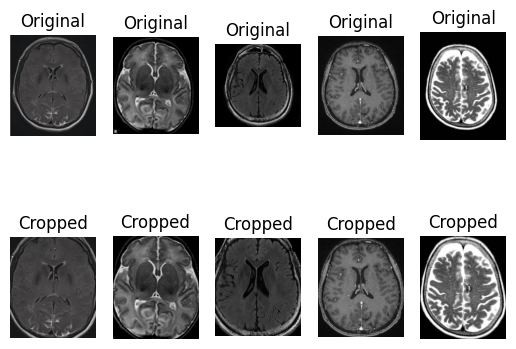

In [ ]:
import matplotlib.pyplot as plt

# Display original and cropped images
num_samples = 5

for i in range(num_samples):
    # Original image
    plt.subplot(2, num_samples, i + 1)
    plt.imshow(X_train[i])
    plt.title('Original')
    plt.axis('off')

    # Cropped image
    plt.subplot(2, num_samples, i + num_samples + 1)
    plt.imshow(X_train_crop[i])
    plt.title('Cropped')
    plt.axis('off')

plt.show()


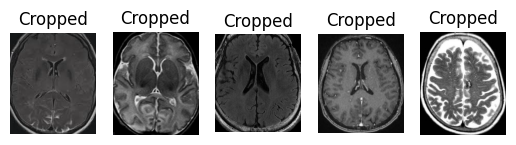

In [ ]:
# Display cropped images
num_samples = 5

for i in range(num_samples):
    plt.subplot(1, num_samples, i + 1)
    plt.imshow(X_train_crop[i])
    plt.title('Cropped')
    plt.axis('off')

plt.show()


In [ ]:
def preprocess_imgs(set_name, img_size):
    """
    Resize and apply VGG-15 preprocessing
    """
    set_new = []
    for img in set_name:
        img = cv2.resize(
            img,
            dsize=img_size,
            interpolation=cv2.INTER_CUBIC
        )
        set_new.append(preprocess_input(img))
    return np.array(set_new)

In [ ]:
X_train_prep = preprocess_imgs(set_name=X_train_crop, img_size=IMG_SIZE)
X_test_prep = preprocess_imgs(set_name=X_test_crop, img_size=IMG_SIZE)
X_val_prep = preprocess_imgs(set_name=X_val_crop, img_size=IMG_SIZE)

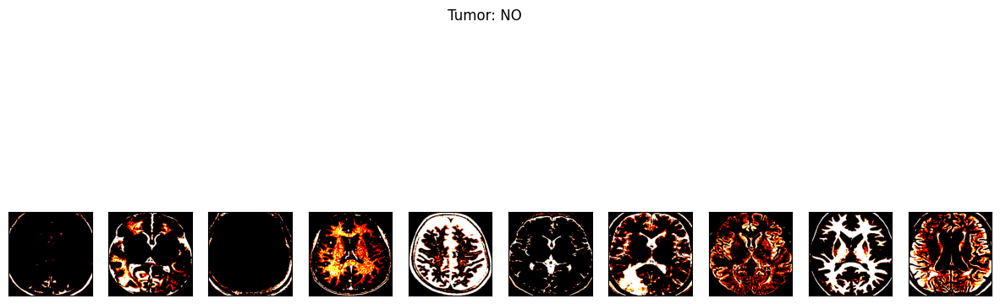

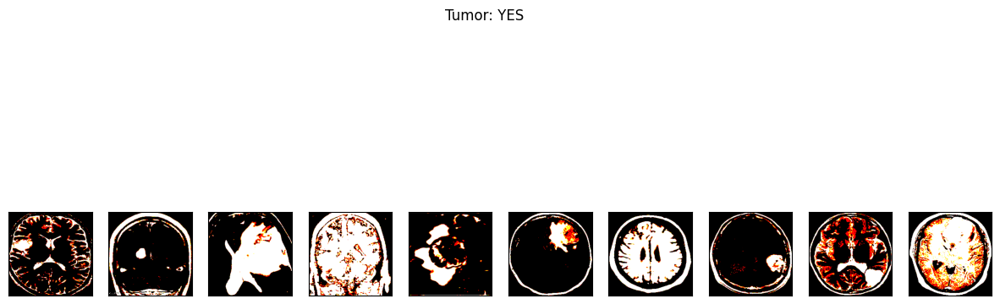

In [ ]:
 plot_samples(X_train_prep, y_train, labels, 10)

In [ ]:
# set the paramters we want to change randomly
demo_datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.05,
    height_shift_range=0.05,
    rescale=1./255,
    shear_range=0.05,
    brightness_range=[0.1, 1.5],
    horizontal_flip=True,
    vertical_flip=True
)

In [ ]:
os.mkdir('preview')
x = X_train_crop[0]
x = x.reshape((1,) + x.shape)

i = 0
for batch in demo_datagen.flow(x, batch_size=1, save_to_dir='preview', save_prefix='aug_img', save_format='jpg'):
    i += 1
    if i > 20:
        break

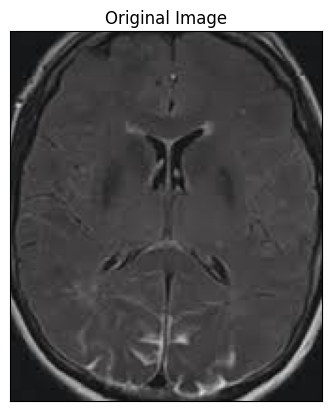

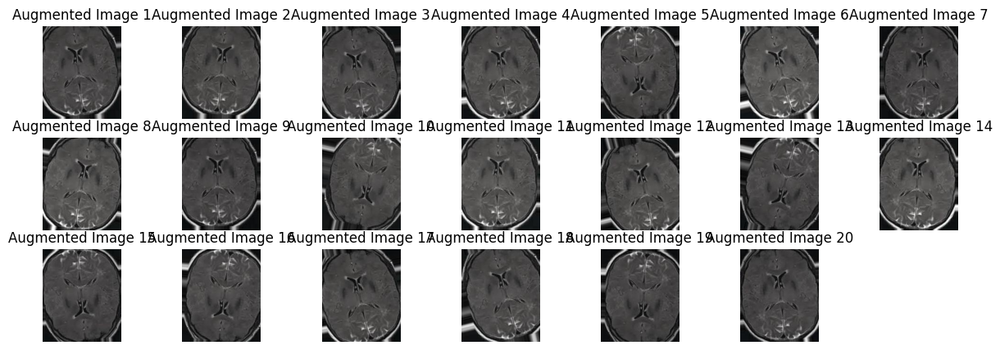

In [ ]:
import cv2
import matplotlib.pyplot as plt
import os

plt.imshow(X_train_crop[0])
plt.xticks([])
plt.yticks([])
plt.title('Original Image')
plt.show()

# Plotting images from the 'preview' directory with titles
plt.figure(figsize=(15, 5))
i = 1

for img in os.listdir('preview/'):
    img_path = os.path.join('preview/', img)
    augmented_img = cv2.imread(img_path)
    augmented_img = cv2.cvtColor(augmented_img, cv2.COLOR_BGR2RGB)

    plt.subplot(3, 7, i)
    plt.imshow(augmented_img)
    plt.title('Augmented Image {}'.format(i))  # Add title indicating it's an augmented image
    plt.axis('off')
    i += 1

plt.show()

In [ ]:
!rm -rf preview/

In [ ]:
TRAIN_DIR = 'TRAIN_CROP/'
VAL_DIR = 'VAL_CROP/'

train_datagen = ImageDataGenerator(
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    brightness_range=[0.5, 1.5],
    horizontal_flip=True,
    vertical_flip=True,
    preprocessing_function=preprocess_input
)

test_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input
)


train_generator = train_datagen.flow_from_directory(
    TRAIN_DIR,
    color_mode='rgb',
    target_size=IMG_SIZE,
    batch_size=32,
    class_mode='binary',
    seed=RANDOM_SEED
)


validation_generator = test_datagen.flow_from_directory(
    VAL_DIR,
    color_mode='rgb',
    target_size=IMG_SIZE,
    batch_size=16,
    class_mode='binary',
    seed=RANDOM_SEED
)

Found 224 images belonging to 2 classes.
Found 83 images belonging to 2 classes.


In [ ]:
from keras.applications import VGG16, InceptionV3, ResNet50
from keras.preprocessing import image
from keras.applications.vgg16 import preprocess_input as vgg16_preprocess_input
from keras.applications.inception_v3 import preprocess_input as inception_v3_preprocess_input
from keras.applications.resnet50 import preprocess_input as resnet50_preprocess_input
from keras.applications.vgg16 import decode_predictions as vgg16_decode_predictions
from keras.applications.inception_v3 import decode_predictions as inception_v3_decode_predictions
from keras.applications.resnet50 import decode_predictions as resnet50_decode_predictions


In [ ]:
# Load VGG16
vgg16_model = VGG16(weights='imagenet')

# Load InceptionV3
inceptionv3_model = InceptionV3(weights='imagenet')

# Load ResNet50
resnet50_model = ResNet50(weights='imagenet')


102967424/102967424 [==============================] - 1s 0us/step


In [ ]:
!pip install umap-learn
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import math
import cv2
import matplotlib.pyplot as plt
import os
import seaborn as sns
from PIL import Image
from scipy import misc
from os import listdir
from os.path import isfile, join
import numpy as np
import umap
from scipy import misc
from random import shuffle
from collections import Counter
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense
from keras.utils import to_categorical
from keras.layers import Input

In [ ]:
import os
import sys
import random
import warnings

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

from tqdm import tqdm
from itertools import chain
from skimage.io import imread, imshow, imread_collection, concatenate_images
from skimage.transform import resize
from skimage.morphology import label

from keras.models import Model, load_model
from keras.layers import Input
from keras.layers import Dropout, Lambda
from tensorflow.keras.layers import Conv2D, Conv2DTranspose
from tensorflow.keras.layers import MaxPooling2D
from keras.layers import concatenate
from keras.callbacks import EarlyStopping, ModelCheckpoint
from keras import backend as K
import keras

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
Total params: 1792 (7.00 KB)
Trainable params: 1792 (7.00 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________
1/1 [==============================] - 0s 243ms/step


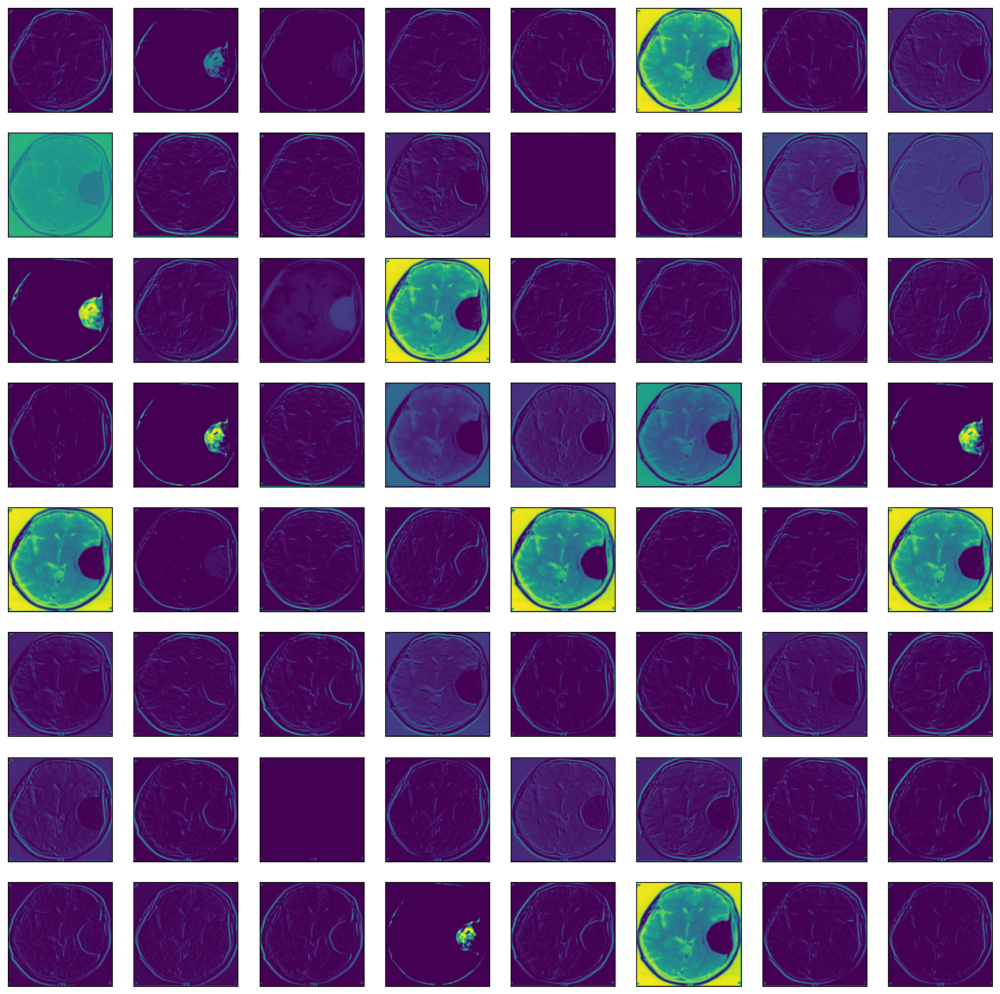

In [ ]:
# plot feature map of first conv layer for given image
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.models import Model
from matplotlib import pyplot
from numpy import expand_dims


f = plt.figure(figsize=(16,16))
# load the modelf = plt.figure(figsize=(10,3))
model = VGG16()
# redefine model to output right after the first hidden layer
model = Model(inputs=model.inputs, outputs=model.layers[1].output)
model.summary()
# load the image with the required shape
# convert the image to an array
img = img_to_array(X_val_prep[43])
# expand dimensions so that it represents a single 'sample'
img = expand_dims(img, axis=0)
# prepare the image (e.g. scale pixel values for the vgg)
img = preprocess_input(img)
# get feature map for first hidden layer
feature_maps = model.predict(img)
# plot all 64 maps in an 8x8 squares
square = 8
ix = 1
for _ in range(square):
	for _ in range(square):
		# specify subplot and turn of axis
		ax = pyplot.subplot(square, square, ix)
		ax.set_xticks([])
		ax.set_yticks([])
		# plot filter channel in grayscale
		pyplot.imshow(feature_maps[0, :, :, ix-1], cmap='viridis')
		ix += 1
# show the figure
pyplot.show()

In [ ]:
from keras.applications import VGG16

# Load VGG16 model with pre-trained weights
vgg = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
from keras.models import Sequential
from keras import layers

# Create a new Sequential model
vgg16 = Sequential()

# Add the pre-trained VGG16 model to the new model
vgg16.add(vgg)
vgg16.add(layers.Dropout(0.3))
vgg16.add(layers.Flatten())

# Continue building the rest of your model...



In [ ]:
NUM_CLASSES = 1

vgg16 = Sequential()
vgg16.add(vgg)
vgg16.add(layers.Dropout(0.3))
vgg16.add(layers.Flatten())
vgg16.add(layers.Dropout(0.5))
vgg16.add(layers.Dense(NUM_CLASSES, activation='sigmoid'))

vgg16.layers[0].trainable = False
vgg16.compile(
    loss='binary_crossentropy',
    optimizer=keras.optimizers.Adam(
        learning_rate=0.0003,
        beta_1=0.9,
        beta_2=0.999,
        epsilon=None,
        amsgrad=False
    ),
    metrics=["accuracy"]
)

vgg16.compile(loss='binary_crossentropy', optimizer=keras.optimizers.Adam(lr=0.0003, beta_1=0.9, beta_2=0.999, epsilon=None, amsgrad=False), metrics=["accuracy"])

vgg16.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  
                                                                 
 dropout_9 (Dropout)         (None, 7, 7, 512)         0         
                                                                 
 flatten_5 (Flatten)         (None, 25088)             0         
                                                                 
 dropout_10 (Dropout)        (None, 25088)             0         
                                                                 
 dense_4 (Dense)             (None, 1)                 25089     
                                                                 
Total params: 14739777 (56.23 MB)
Trainable params: 25089 (98.00 KB)
Non-trainable params: 14714688 (56.13 MB)
_________________________________________________________________


1/1 [==============================] - 0s 473ms/step


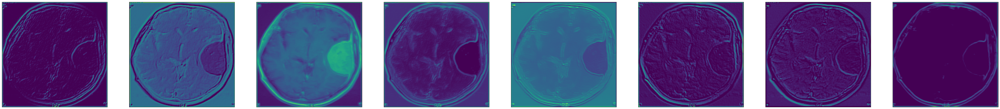

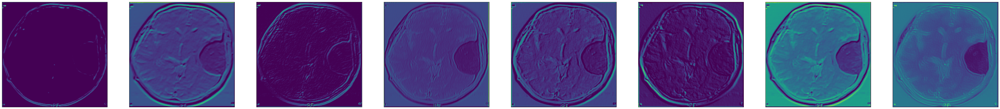

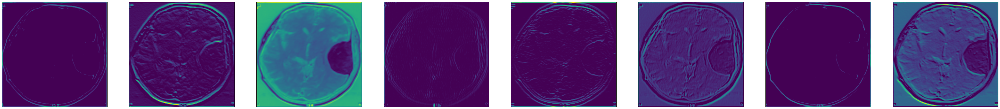

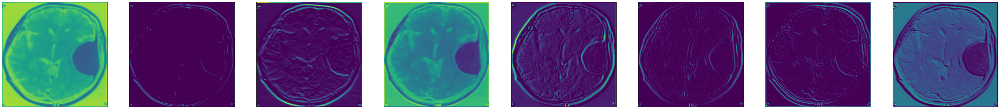

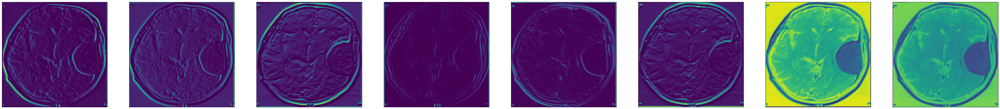

...

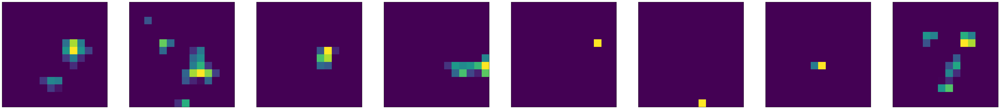

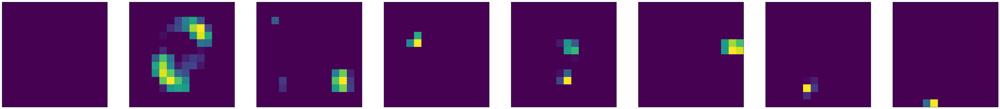

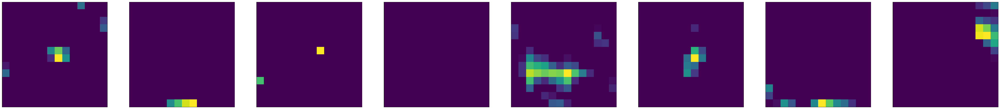

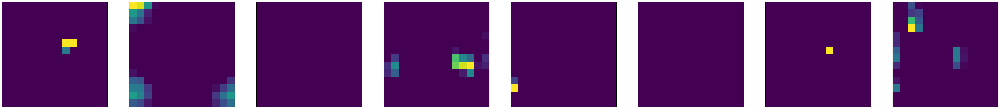

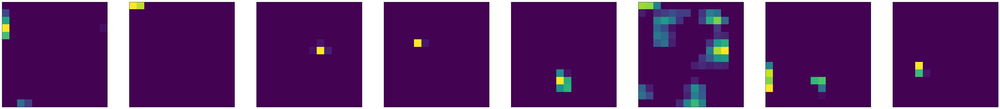

In [ ]:
# visualize feature maps output from each block in the vgg model
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from keras.preprocessing.image import load_img
from keras.preprocessing.image import img_to_array
from keras.models import Model
import matplotlib.pyplot as plt
from numpy import expand_dims




# load the model
model = VGG16()
# redefine model to output right after the first hidden layer
ixs = [2, 5, 9, 13, 17]
outputs = [model.layers[i].output for i in ixs]
model = Model(inputs=model.inputs, outputs=outputs)
# load the image with the required shape
# convert the image to an array
img = img_to_array(X_val_prep[43])
# expand dimensions so that it represents a single 'sample'
img = expand_dims(img, axis=0)
# prepare the image (e.g. scale pixel values for the vgg)
img = preprocess_input(img)
# get feature map for first hidden layer
feature_maps = model.predict(img)
# plot the output from each block
square = 8
for fmap in feature_maps:
	# plot all 64 maps in an 8x8 squares
	ix = 1
	for _ in range(square):
		plt.figure(figsize=(64,64))
		for _ in range(square):


			# specify subplot and turn of axis
			ax = pyplot.subplot(square, square, ix)
			ax.set_xticks([])
			ax.set_yticks([])

			# plot filter channel in grayscale
			plt.imshow(fmap[0, :, :, ix-1], cmap='viridis')
			ix += 1
	# show the figure


	plt.show()

In [ ]:
vgg16.compile(
    loss='sparse_categorical_crossentropy',
    optimizer=keras.optimizers.Adam(learning_rate=0.0003),
    metrics=['accuracy']
)

In [ ]:
# Print information about the dataset
for data_batch, labels_batch in train_generator:
    print('Data batch shape:', data_batch.shape)
    print('Labels batch shape:', labels_batch.shape)
    break  # Break after printing the first batch to avoid an infinite loop

# Assuming your model is named vgg16 and has an input shape (224, 224, 3)
vgg16 = Sequential()
vgg16.add(vgg)  # Assuming vgg is your loaded model
vgg16.add(layers.Dropout(0.3))
vgg16.add(layers.Flatten())
vgg16.add(layers.Dense(256, activation='relu'))
vgg16.add(layers.Dense(1, activation='sigmoid'))  # Output layer

# Compile the model
vgg16.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

# Train the model
vgg16_history = vgg16.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs= 20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator)
)



Data batch shape: (32, 224, 224, 3)
Labels batch shape: (32,)
Epoch 1/20
7/7 [==============================] - 130s 19s/step - loss: 14.4842 - accuracy: 0.6518 - val_loss: 2.4992 - val_accuracy: 0.7470
Epoch 2/20
7/7 [==============================] - 118s 17s/step - loss: 4.5218 - accuracy: 0.7054 - val_loss: 2.2670 - val_accuracy: 0.7108
Epoch 3/20
7/7 [==============================] - 127s 19s/step - loss: 1.4374 - accuracy: 0.7991 - val_loss: 0.8110 - val_accuracy: 0.8072
Epoch 4/20
7/7 [==============================] - 118s 17s/step - loss: 0.9987 - accuracy: 0.7946 - val_loss: 0.9729 - val_accuracy: 0.7831
Epoch 5/20
7/7 [==============================] - 127s 19s/step - loss: 0.7060 - accuracy: 0.8393 - val_loss: 0.4034 - val_accuracy: 0.8193
Epoch 6/20
7/7 [==============================] - 118s 18s/step - loss: 0.4451 - accuracy: 0.8571 - val_loss: 0.6172 - val_accuracy: 0.7952
Epoch 7/20
7/7 [==============================] - 127s 19s/step - loss: 0.2943 - accuracy: 0.8929

In [ ]:
# validate on val set
predictions = vgg16.predict(X_test_prep)
predictions = [1 if x>0.5 else 0 for x in predictions]

_, train_acc = vgg16.evaluate(X_val_prep, y_val, verbose=0)
_, test_acc = vgg16.evaluate(X_test_prep, y_test, verbose=0)

1/1 [==============================] - 5s 5s/step


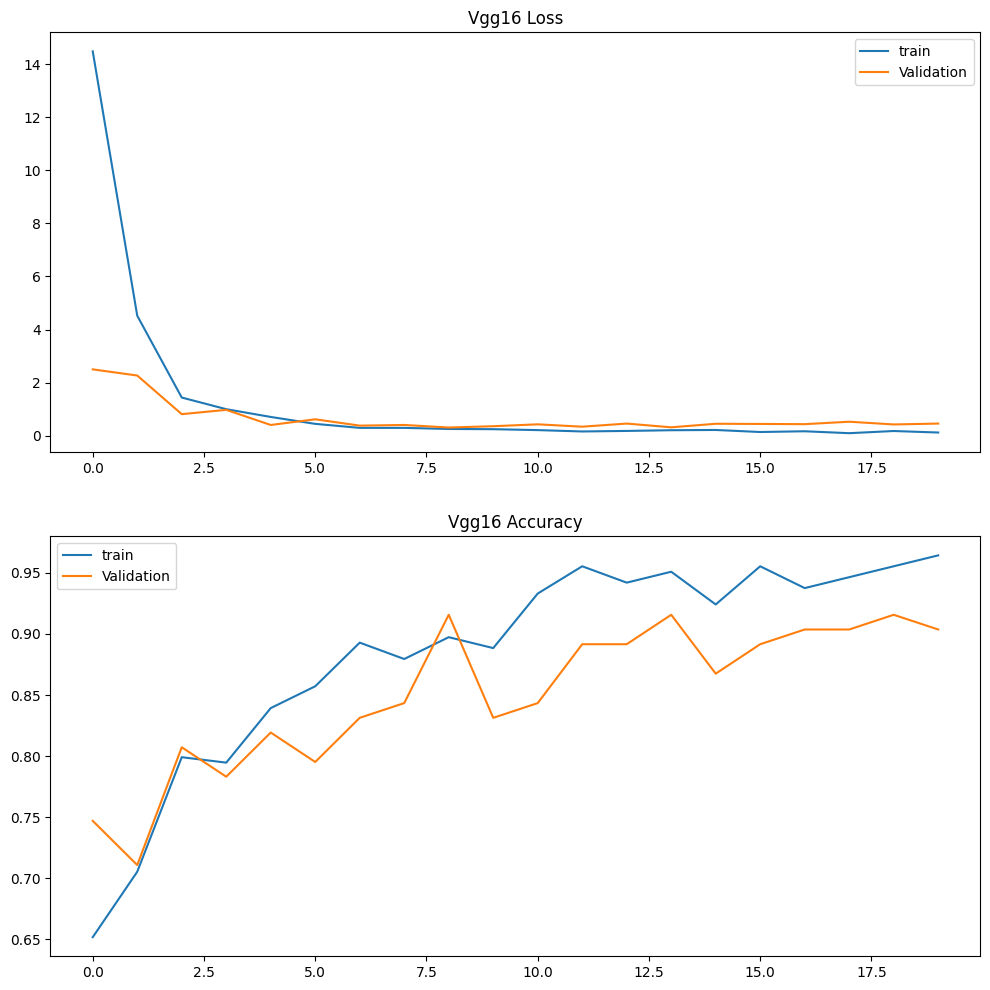

In [ ]:
import matplotlib.pyplot as pyplot

# Assuming you have a vgg16_history object from model training

# plot loss during training
pyplot.figure(figsize=(12, 12))
pyplot.subplot(211)
pyplot.title('Vgg16 Loss')
pyplot.plot(vgg16_history.history['loss'], label='train')
pyplot.plot(vgg16_history.history['val_loss'], label='Validation')
pyplot.legend()

# plot accuracy during training
pyplot.subplot(212)
pyplot.title('Vgg16 Accuracy')
pyplot.plot(vgg16_history.history['accuracy'], label='train')
pyplot.plot(vgg16_history.history['val_accuracy'], label='Validation')
pyplot.legend()

pyplot.show()


In [ ]:
print('Train: %.3f, Test: %.3f' % (train_acc, test_acc))

Train: 0.882, Test: 0.800


In [ ]:
from sklearn.datasets import make_circles
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import Dense

# accuracy: (tp + tn) / (p + n)
accuracy = accuracy_score(y_test, predictions)
print('Accuracy: %f' % accuracy)
# precision tp / (tp + fp)
precision = precision_score(y_test, predictions)
print('Precision: %f' % precision)
# recall: tp / (tp + fn)
recall = recall_score(y_test, predictions)
print('Recall: %f' % recall)
# f1: 2 tp / (2 tp + fp + fn)
f1 = f1_score(y_test, predictions)
print('F1 score: %f' % f1)

Accuracy: 0.800000
Precision: 0.714286
Recall: 1.000000
F1 score: 0.833333


In [ ]:
kappa = cohen_kappa_score(y_test, predictions)
print('Cohens kappa: %f' % kappa)
# ROC AUC
auc = roc_auc_score(y_test, predictions)
print('ROC AUC: %f' % auc)
# confusion matrix
matrix = confusion_matrix(y_test, predictions)
print(matrix)

Cohens kappa: 0.600000
ROC AUC: 0.800000
[[3 2]
 [0 5]]


In [ ]:
def ModelGraphTrainngSummaryAcc(history, N, model_name):
    # set the matplotlib backend so figures can be saved in the background
    # plot the training loss and accuracy
    import sys
    import matplotlib
    print("Generating plots...")
    sys.stdout.flush()
    matplotlib.use("Agg")
    matplotlib.pyplot.style.use("ggplot")
    matplotlib.pyplot.figure()

    # Use 'accuracy' instead of 'acc'
    matplotlib.pyplot.plot(np.arange(0, N), history.history["accuracy"], label="train_acc")
    matplotlib.pyplot.plot(np.arange(0, N), history.history["val_accuracy"], label="val_acc")

    matplotlib.pyplot.title("Training Loss and Accuracy on Brain Tumor Classification")
    matplotlib.pyplot.xlabel("Epoch #")
    matplotlib.pyplot.ylabel("Loss/Accuracy of " + model_name)
    matplotlib.pyplot.legend(loc="lower left")

    # Save the plot
    matplotlib.pyplot.savefig("plot_acc.png")

    # Show the plot in the notebook
    matplotlib.pyplot.show()


In [ ]:
def ModelGraphTrainngSummaryAcc(history, N, model_name):
    # set the matplotlib backend so figures can be saved in the background
    # plot the training loss and accuracy
    import sys
    import matplotlib.pyplot as plt

    print("Generating plots...")
    sys.stdout.flush()
    plt.style.use("ggplot")
    plt.figure()

    # Use 'accuracy' instead of 'acc'
    plt.plot(np.arange(0, N), history.history["accuracy"], label="train_acc")
    plt.plot(np.arange(0, N), history.history["val_accuracy"], label="val_acc")

    plt.title("Training Loss and Accuracy on Brain Tumor Classification")
    plt.xlabel("Epoch #")
    plt.ylabel("Loss/Accuracy of " + model_name)
    plt.legend(loc="lower left")

    # Save the plot
    plt.savefig("plot_acc.png")

    # Display the plot in the notebook
    plt.show()


In [ ]:
# Set the maximum number of open figures warning
plt.rcParams['figure.max_open_warning'] = 100  # You can adjust this number as needed


In [ ]:
history_1= vgg16_history

In [ ]:
# Define the VGG-16 model and its history
vgg16_model_and_history = {'name': 'VGG-16', 'history': history_1, 'model': vgg16}

# Generate plots for VGG-16
ModelGraphTrainngSummary(vgg16_model_and_history['history'], 20, vgg16_model_and_history['name'])
ModelGraphTrainngSummaryAcc(vgg16_model_and_history['history'], 20, vgg16_model_and_history['name'])

# Validate on the validation set
predictions = vgg16_model_and_history['model'].predict(X_val_prep)
predictions = [1 if x > 0.5 else 0 for x in predictions]

accuracy = accuracy_score(y_val, predictions)
print(f'{vgg16_model_and_history["name"]} Validation Accuracy = {accuracy:.2f}')

confusion_mtx = confusion_matrix(y_val, predictions)
cm = plot_confusion_matrix(confusion_mtx, classes=list(labels.items()), normalize=False)


Generating plots...
Generating plots...
2/2 [==============================] - 20s 7s/step
VGG-16 Validation Accuracy = 0.88


In [156]:
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import numpy as np

# Assuming y_val and predictions are your true labels and predicted labels, respectively

# Compute confusion matrix
confusion_mtx = confusion_matrix(y_val, predictions)

# Plot confusion matrix
plt.figure(figsize=(8, 8))
plt.imshow(confusion_mtx, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()

# Set tick marks
classes = list(labels.items())
tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation=45)
plt.yticks(tick_marks, classes)

# Display values inside the plot
thresh = confusion_mtx.max() / 2.
for i in range(confusion_mtx.shape[0]):
    for j in range(confusion_mtx.shape[1]):
        plt.text(j, i, format(confusion_mtx[i, j], 'd'),
                 ha="center", va="center",
                 color="white" if confusion_mtx[i, j] > thresh else "black")

plt.ylabel('True label')
plt.xlabel('Predicted label')
plt.tight_layout()

plt.savefig('confusion_matrix.png')
# Show the plot
plt.show()

